In [7]:
%load_ext lab_black

In [1]:
# one hot encode runway
# ordinal encode airline
# TODO: Try with avg pb time, ratioH/M, ratio nominal
from traffic.core import Traffic

import pandas as pd
import numpy as np
import pickle

import os.path

from ipyleaflet import Polygon
from ipywidgets import Layout
from ipyleaflet import Map, Marker

import altair as alt

from cartes.osm import Overpass

from sklearn import svm

from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import RepeatedStratifiedKFold
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import classification_report, confusion_matrix

from numpy import mean
from numpy import std
from sklearn.compose import ColumnTransformer
from sklearn.datasets import fetch_openml
from sklearn.pipeline import Pipeline
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import StandardScaler, OneHotEncoder, OrdinalEncoder
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split, GridSearchCV

In [11]:
alt.data_transformers.disable_max_rows()

DataTransformerRegistry.enable('default')

# Load df

In [606]:
dep_arr_df = pd.read_pickle("../data/processed/dep_arr_df2.pkl")
dep_arr_df

/home/service/miniconda3/envs/py39v7/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


,flight_id,on_runway_time,taxi_holding_time,rwy_holding_time,total_holding_time,taxi_holding_time_minutes,first_movement,callsign,registration,typecode,...,nb,icao_wtc,H,L,L/M,M,H_count,L_count,L/M_count,M_count
0,GSW4942_15738,2019-10-01 04:00:28+00:00,0 days 00:01:23,None,0 days 00:01:23,1.383333,2019-10-01 03:59:06+00:00,GSW4942,HB-JOG,A319,...,NaN,M,0,0,0,1,0.0,0.0,0.0,1.0
2,SWR177_15809,2019-10-01 04:05:11+00:00,0 days 00:00:00,None,0 days 00:00:00,0.000000,2019-10-01 04:05:48+00:00,SWR177,HB-JNI,B77W,...,3.0,H,1,0,0,0,1.0,0.0,0.0,1.0
3,SWR139_15706,2019-10-01 04:07:25+00:00,0 days 00:00:00,None,0 days 00:00:00,0.000000,2019-10-01 04:07:33+00:00,SWR139,HB-JNG,B77W,...,4.0,H,1,0,0,0,2.0,0.0,0.0,1.0
4,SWR296_13638,2019-10-01 04:09:53+00:00,0 days 00:00:00,None,0 days 00:00:00,0.000000,2019-10-01 04:10:25+00:00,SWR296,HB-JHM,A333,...,5.0,H,1,0,0,0,3.0,0.0,0.0,1.0
1,EDW200_5718,2019-10-01 04:10:37+00:00,0 days 00:01:18,None,0 days 00:04:56,1.300000,2019-10-01 04:03:36+00:00,EDW200,HB-IHZ,A320,...,2.0,M,0,0,0,1,3.0,0.0,0.0,2.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
35539,THY8HD_18663,2019-11-30 21:49:30+00:00,0 days 00:00:00,None,0 days 00:00:00,0.000000,2019-11-30 21:49:52+00:00,THY8HD,TC-JTN,A321,...,10.0,M,0,0,0,1,1.0,0.0,0.0,7.0
35538,SWR288_13280,2019-11-30 21:49:46+00:00,0 days 00:02:03,None,0 days 00:02:03,2.050000,2019-11-30 21:46:26+00:00,SWR288,HB-JHI,A333,...,10.0,H,1,0,0,0,2.0,0.0,0.0,6.0
35537,SWR176_15653,2019-11-30 22:02:47+00:00,0 days 00:02:16,None,0 days 00:15:41,2.266667,2019-11-30 21:44:51+00:00,SWR176,HB-JNJ,B77W,...,9.0,H,1,0,0,0,3.0,0.0,0.0,4.0
35540,SWR92_15689,2019-11-30 22:04:18+00:00,0 days 00:03:29,None,0 days 00:09:35,3.483333,2019-11-30 21:53:56+00:00,SWR92,None,None,...,9.0,NaN,0,0,0,0,3.0,0.0,0.0,4.0


# Pushbacks

In [607]:
datachart = dep_arr_df.query("config=='NORTH0' & mvt_type=='DEP' & end_pb==end_pb")[
    ["pb_duration_minutes"]
].dropna()

alt.Chart(datachart).transform_density(
    "pb_duration_minutes", as_=["pb_duration_minutes", "density"], extent=[0, 20]
).mark_line().encode(x=alt.X("pb_duration_minutes:Q"), y="density:Q").properties(
    title="Density distribution of pushback duration"
)

/home/service/miniconda3/envs/py39v7/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


alt.Chart(...)

# Difference between 'taxi' and 'total' holding time

In [22]:
dep_arr_df.query("config=='NORTH0' & mvt_type=='DEP' & end_pb==end_pb")[
    ["taxi_holding_time_minutes", "total_holding_time_minutes", "pb_duration_minutes"]
].describe()

,taxi_holding_time_minutes,total_holding_time_minutes,pb_duration_minutes
count,4553.000000,4553.000000,4553.000000
mean,3.648115,6.724098,2.598803
std,3.767111,4.638540,2.632824
min,0.000000,0.000000,-4.316667
25%,1.050000,3.733333,0.883333
50%,2.633333,6.116667,1.600000
75%,5.316667,8.866667,3.916667
max,52.833333,63.266667,61.183333


In [25]:
datachart = dep_arr_df.query("config=='NORTH0' & mvt_type=='DEP' & end_pb==end_pb")[
    ["taxi_holding_time_minutes", "total_holding_time_minutes", "pb_duration_minutes"]
]
taxichart = (
    alt.Chart(datachart)
    .transform_density(
        "taxi_holding_time_minutes",
        as_=["taxi_holding_time_minutes", "density"],
        extent=[0, 20],
    )
    .mark_line()
    .encode(x=alt.X("taxi_holding_time_minutes:Q"), y="density:Q")
)

totalchart = (
    alt.Chart(datachart)
    .transform_density(
        "total_holding_time_minutes",
        as_=["total_holding_time_minutes", "density"],
        extent=[0, 20],
    )
    .mark_line(color="red")
    .encode(x=alt.X("total_holding_time_minutes:Q"), y="density:Q")
)

taxichart + totalchart

alt.LayerChart(...)

# Difference between total_holding and previous delays

In [617]:
dep_df_new = dep_arr_df.query('mvt_type=="DEP"')

/home/service/miniconda3/envs/py39v7/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [549]:
fdf_dep_path = "../data/intermediate/flight_df_v18_2019-10-01 03:58:59+00:00_2019-11-30 22:14:59+00:00_DEP.pkl"
dep_df_old = pd.read_pickle(fdf_dep_path)

len(dep_df_old), len(dep_df_new)

(16339, 16464)

In [40]:
delay_dif_df = (
    dep_df_old[["flight_id", "total_holding_time_minutes"]]
    .merge(dep_df_new[["flight_id", "total_holding_time_minutes"]], on=("flight_id"))
    .assign(
        dif_delay=lambda x: (
            x.total_holding_time_minutes_y - x.total_holding_time_minutes_x
        )
    )
)


delay_dif_df["dif_delay"] = delay_dif_df["dif_delay"].abs()

delay_dif_df.dif_delay.describe()

count    16344.000000
mean         0.046108
std          0.295513
min          0.000000
25%          0.000000
50%          0.000000
75%          0.000000
max          6.383333
Name: dif_delay, dtype: float64

# Time between 2 departures having full taxi trajectory

In [43]:
time_between_2fulldep = (
    dep_df_new.query("end_pb==end_pb")
    .sort_values("first_movement_start")["first_movement_start"]
    .diff()
    .dt.total_seconds()
    / 60
)

<AxesSubplot:>

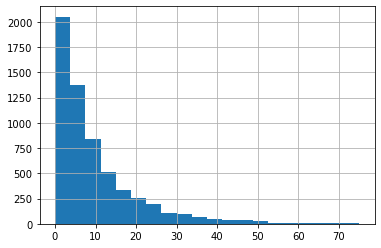

In [48]:
(time_between_2fulldep.hist(bins=20, range=(0, 75)))

/home/service/miniconda3/envs/py39v7/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


<AxesSubplot:>

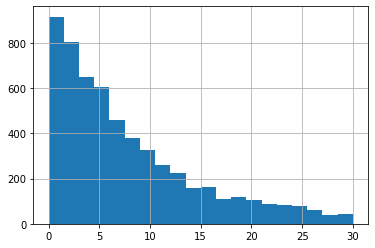

In [227]:
time_between_2fulldep.hist(bins=20, range=(0, 30))

Linear repartition between 0 and 10 mins
+ there is flights with much more time between departures

=> Using LSTM based on a flight granularity per day would not be that relevant in this case

# What are correlations with target variable ?

In [608]:
pearsoncorr = dep_arr_df.query("end_pb==end_pb & mvt_type=='DEP'").corr(
    method="pearson"
)
pearsoncorr

/home/service/miniconda3/envs/py39v7/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


,taxi_holding_time_minutes,cumdist_max,duration_minutes,parking_position_duration_minutes,pb_duration_minutes,taxi_dist,total_holding_time_minutes,real_dur_minutes,hh_num,angle_sum,...,nb_dep,nb,H,L,L/M,M,H_count,L_count,L/M_count,M_count
taxi_holding_time_minutes,1.000000,5.919906e-02,0.554835,0.159088,-0.138193,0.094377,0.792505,0.755027,-0.129429,0.582159,...,2.845810e-01,0.161899,0.215454,NaN,NaN,-0.168277,0.205995,0.030975,-0.004658,0.058079
cumdist_max,0.059199,1.000000e+00,0.203156,0.017295,0.220637,0.630342,0.049962,0.112046,0.119948,-0.006045,...,-1.188505e-07,0.017414,0.092938,NaN,NaN,-0.088801,-0.050319,0.002408,0.001398,0.028776
duration_minutes,0.554835,2.031562e-01,1.000000,0.703623,0.107872,0.185647,0.651779,0.671095,-0.093097,0.446660,...,2.109892e-01,0.139855,0.222036,NaN,NaN,-0.239443,0.140795,0.034780,0.006986,0.061436
parking_position_duration_minutes,0.159088,1.729485e-02,0.703623,1.000000,-0.045665,0.051502,0.199461,0.170014,-0.078375,0.150929,...,6.103377e-02,0.055687,-0.001522,NaN,NaN,-0.044347,0.021078,0.037558,-0.007936,0.037747
pb_duration_minutes,-0.138193,2.206369e-01,0.107872,-0.045665,1.000000,0.325386,0.198994,0.224983,0.087142,0.087975,...,-5.542480e-02,-0.016993,0.062770,NaN,NaN,-0.082642,-0.040553,-0.026956,0.033602,-0.005937
taxi_dist,0.094377,6.303417e-01,0.185647,0.051502,0.325386,1.000000,0.086321,0.189825,0.004582,0.009851,...,1.900745e-03,0.008621,0.033229,NaN,NaN,-0.047986,0.007344,-0.003444,0.001460,-0.007973
total_holding_time_minutes,0.792505,4.996210e-02,0.651779,0.199461,0.198994,0.086321,1.000000,0.929746,-0.099750,0.687700,...,2.479340e-01,0.147230,0.277278,NaN,NaN,-0.235118,0.196179,0.013927,0.009478,0.048343
real_dur_minutes,0.755027,1.120459e-01,0.671095,0.170014,0.224983,0.189825,0.929746,1.000000,-0.107555,0.675323,...,2.483184e-01,0.146800,0.340900,NaN,NaN,-0.295081,0.239366,0.001382,0.014864,0.025861
hh_num,-0.129429,1.199481e-01,-0.093097,-0.078375,0.087142,0.004582,-0.099750,-0.107555,1.000000,-0.064107,...,-1.549327e-01,-0.005435,0.081198,NaN,NaN,-0.032253,-0.303165,-0.030532,-0.014902,0.119017
angle_sum,0.582159,-6.045276e-03,0.446660,0.150929,0.087975,0.009851,0.687700,0.675323,-0.064107,1.000000,...,1.527614e-01,0.101673,0.005488,NaN,NaN,0.005258,0.052729,0.020732,0.009926,0.078134


In [609]:
import seaborn as sb
import matplotlib.pyplot as plt

/home/service/miniconda3/envs/py39v7/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


<AxesSubplot:>

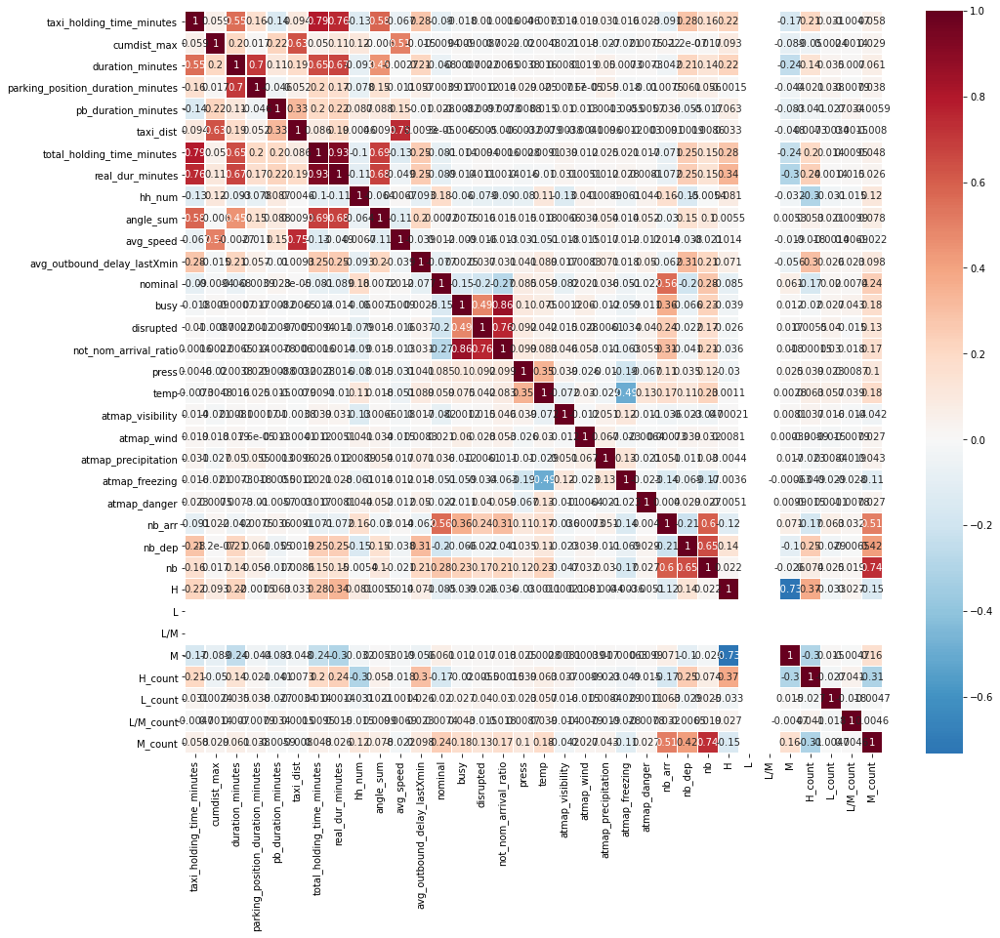

In [610]:
plt.figure(figsize=(16, 14))
sb.heatmap(
    pearsoncorr,
    xticklabels=pearsoncorr.columns,
    yticklabels=pearsoncorr.columns,
    cmap="RdBu_r",
    center=0,
    annot=True,
    linewidth=0.5,
)

<AxesSubplot:>

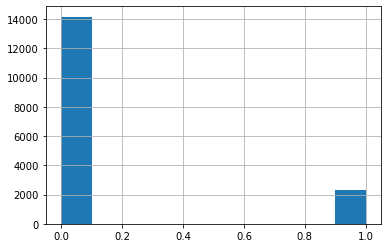

In [363]:
dep_df_new.H.hist()

# Number of movements and delay

In [547]:
datachart = (
    dep_arr_df[
        [
            "nb_arr",
            "nb_dep",
            "nb",
            "total_holding_time_minutes",
            "hh_num",
            "hh",
            "first_movement_start",
            "mvt_type",
            "avg_outbound_delay_lastXmin",
        ]
    ]
    .query('mvt_type=="DEP"')
    .assign(day=lambda x: x.hh.dt.day)
    .assign(month=lambda x: x.hh.dt.month)
    .sort_values("first_movement_start")
    .fillna(method="backfill")
)

In [564]:
selection = alt.selection_multi(fields=["day", "month"])
color = alt.condition(
    selection, alt.Color("month:N", legend=None), alt.value("lightgray")
)

# 2month plot

arr_chart = (
    alt.Chart(datachart)
    .mark_line(color="orange")
    .encode(
        x="hh_num:O",
        y="mean(nb_arr):Q",
        opacity="day:O",
        color=color,
    )
)

dep_chart = (
    alt.Chart(datachart)
    .mark_line(color="blue")
    .encode(
        alt.Tooltip("day"),
        x="hh_num:O",
        y="mean(nb_dep):Q",
        opacity="day:O",
        color=color,
    )
)

delay_chart = (
    alt.Chart(datachart)
    .mark_line(color="red")
    .encode(
        x="hh_num:O",
        y="mean(total_holding_time_minutes):Q",
    )
)

daymonth_datachart = datachart[["day", "month"]].drop_duplicates()

# Plot to select day
choose_date = (
    alt.Chart(daymonth_datachart)
    .mark_rect(color="lightblue")
    .encode(y="day:O", x="month:O", color=color)
).add_selection(selection)

# plot to display selected day
selected_day_dep_chart = (
    alt.Chart(datachart)
    # .transform_fold(["nb_dep", "nb_arr"])
    .mark_line(color="blue").encode(
        x="utchoursminutes(first_movement_start):T",
        y=alt.Y("mean(nb_dep):Q", scale=alt.Scale(domain=[0, 20], clamp=True)),
        opacity="day",
        tooltip=["month", "day"],
    )
).transform_filter(selection)

selected_day_delay_chart = (
    (
        alt.Chart(
            datachart.query("avg_outbound_delay_lastXmin==avg_outbound_delay_lastXmin")
        )
        .mark_line(color="red")
        .encode(
            x="utchoursminutes(first_movement_start):T",
            y=alt.Y(
                "avg_outbound_delay_lastXmin:Q",
                scale=alt.Scale(domain=[0, 20], clamp=True),
            ),
            opacity="day",
            tooltip="month",
        )
    )
    .add_selection(selection)
    .transform_filter(selection)
)

depdel_chart = alt.layer(selected_day_dep_chart, selected_day_delay_chart).properties(
    width=800, height=250
)


all_charts = (
    alt.layer((arr_chart + dep_chart).add_selection(selection), delay_chart)
    .resolve_scale(y="independent")
    .properties(width=800, height=250)
)

(alt.vconcat(all_charts, depdel_chart)) | choose_date

/home/service/miniconda3/envs/py39v7/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


alt.HConcatChart(...)

In [1]:
selected_day_dep_chart

NameError: name 'selected_day_dep_chart' is not defined

In [550]:
dates = [(27, 11), (5, 10), (23, 10), (27, 10), (29, 10)]

dep_df_new_ = dep_df_new.assign(
    day=lambda x: x.hh.dt.day, month=lambda x: x.hh.dt.month
)

l = []
for d, m in dates:
    l.append(dep_df_new_.query(f"day=={d} & month=={m}"))

lowdelay_highnb_days = pd.concat(l)

/home/service/miniconda3/envs/py39v7/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [557]:
lcols = [
    "taxi_holding_time_minutes",
    "runway",
    "hh_num",
    "avg_outbound_delay_lastXmin",
    "nominal",
    "busy",
    "disrupted",
    "press",
    "temp",
    "atmap_visibility",
    "atmap_wind",
    "atmap_precipitation",
    "atmap_freezing",
    "atmap_danger",
    "config",
    "nb_arr",
    "nb_dep",
    "nb",
    "icao_wtc",
    "H",
    "L",
    "L/M",
    "M",
    "H_count",
    "L_count",
    "L/M_count",
    "M_count",
    "not_nom_arrival_ratio",
]
comp_df = lowdelay_highnb_days[lcols].describe().compare(dep_df_new[lcols].describe())

In [560]:
comp_df[["nominal", "busy", "disrupted", "not_nom_arrival_ratio"]]

nominal                       busy                  disrupted  \
              self         other         self         other         self   
count  1402.000000  16443.000000  1402.000000  16443.000000  1402.000000   
mean      9.158345      8.912242     0.166191      0.447850     0.033524   
std       4.068195      3.893941     0.827903      1.382551     0.212769   
min       1.000000      0.000000          NaN           NaN          NaN   
25%            NaN           NaN          NaN           NaN          NaN   
50%            NaN           NaN          NaN           NaN          NaN   
75%            NaN           NaN          NaN           NaN          NaN   
max      19.000000     20.000000     7.000000     14.000000     2.000000   

                    not_nom_arrival_ratio                
              other                  self         other  
count  16443.000000           1402.000000  16464.000000  
mean       0.163960              0.016888      0.052910  
std        0.774155              0.069454      0.158692  
min             NaN                   NaN           NaN  
25%             NaN                   NaN           NaN  
50%             NaN                   NaN           NaN  
75%             NaN                   NaN           NaN  
max       10.000000              0.583333      1.000000

In [ ]:
comp_df[[dep_df]]

### But how can we extract probability distribution out of n_dep ?

#### Linear correlation  ?

In [337]:
datachart = dep_df_new.query("end_pb==end_pb")[["nb_dep", "total_holding_time_minutes"]]
alt.Chart(datachart).mark_boxplot(outliers=False).encode(
    x="nb_dep", y="total_holding_time_minutes", color="count()"
)

alt.Chart(...)

In [339]:
datachart = dep_df_new.query("end_pb==end_pb")[["nb_dep", "total_holding_time_minutes"]]
alt.Chart(datachart).transform_density(
    "total_holding_time_minutes",
    as_=["total_holding_time_minutes", "density"],
    extent=[0, 20],
    groupby=["nb_dep"],
).mark_area(orient="horizontal").encode(
    y="total_holding_time_minutes:Q",
    color="nb_dep:N",
    x=alt.X(
        "density:Q",
        stack="center",
        impute=None,
        title=None,
        axis=alt.Axis(labels=False, values=[0], grid=False, ticks=True),
    ),
    column=alt.Column(
        "nb_dep:N",
        header=alt.Header(
            titleOrient="bottom",
            labelOrient="bottom",
            labelPadding=0,
        ),
    ),
).properties(
    width=50
).configure_facet(
    spacing=0
).configure_view(
    stroke=None
)

alt.Chart(...)

In [ ]:
from sklearn.linear_model import LinearRegression



#### Different delay densities ?

In [611]:
datachart = dep_df_new.query("True==True")[["total_holding_time_minutes", "nb_dep"]]
selection = alt.selection_single(fields=["nb_dep"], bind="legend")
color = alt.condition(selection, alt.Color("nb_dep:O"), alt.value("lightgray"))

delay_distrib_wrt_nbdep_chart = (
    (
        alt.Chart(datachart)
        .transform_density(
            "total_holding_time_minutes", groupby=["nb_dep"], extent=[0, 30]
        )
        .mark_line()
        .encode(x="value:Q", y="density:Q", color=color, tooltip=["nb_dep", "count()"])
    )
    .add_selection(selection)
    .properties(title="delay_distrib_wrt_nbdep_chart")
)
delay_distrib_wrt_nbdep_chart

KeyError: True

In [331]:
datachart = dep_df_new.query("end_pb==end_pb")[
    ["total_holding_time_minutes", "nb_dep"]
].query("nb_dep>=0")
datachart.loc[datachart.nb_dep > 14, "nb_dep_cat"] = ">14"
datachart.loc[datachart.nb_dep <= 14, "nb_dep_cat"] = "<=14"


selection = alt.selection_single(fields=["nb_dep_cat"], bind="legend")
color = alt.condition(selection, alt.Color("nb_dep_cat:O"), alt.value("lightgray"))

delay_distrib_wrt_nbdep_chart = (
    (
        alt.Chart(datachart)
        .transform_density(
            "total_holding_time_minutes", groupby=["nb_dep_cat"], extent=[0, 30]
        )
        .mark_line()
        .encode(
            x="value:Q", y="density:Q", color=color, tooltip=["nb_dep_cat", "count()"]
        )
    )
    .add_selection(selection)
    .properties(title="delay_distrib_wrt_nbdep_chart")
)
delay_distrib_wrt_nbdep_chart

/home/service/miniconda3/envs/py39v7/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


alt.Chart(...)

In [225]:
dep_df_new.nb_dep.value_counts()

13.0    1257
8.0     1237
10.0    1235
11.0    1221
7.0     1196
9.0     1194
14.0    1182
12.0    1167
6.0     1074
15.0    1020
5.0      993
16.0     783
4.0      745
3.0      555
17.0     527
2.0      312
18.0     307
19.0     166
1.0      128
20.0      91
21.0      38
22.0      13
23.0       2
Name: nb_dep, dtype: int64

# Number of movements and delay (not on hh_num)


In [322]:
datachart = (
    dep_arr_df[
        [
            "nb_arr",
            "nb_dep",
            "nb",
            "total_holding_time_minutes",
            "hh_num",
            "hh",
            "first_movement_start",
            "mvt_type",
        ]
    ]
    .assign(day=lambda x: x.hh.dt.day)
    .fillna(0)
)

/home/service/miniconda3/envs/py39v7/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [122]:
arr_chart = (
    alt.Chart(datachart)
    .mark_line(color="orange")
    .encode(x="utchoursminutes(first_movement_start):T", y="nb_arr:Q", opacity="day:O")
)
dep_chart = (
    alt.Chart(datachart)
    .mark_point(color="blue", opacity=0.2)
    .encode(x="utchoursminutes(first_movement_start):T", y="nb_dep:Q")
)
delay_chart = (
    alt.Chart(datachart)
    .mark_line(color="red")
    .encode(
        x="utchoursminutes(first_movement_start):T",
        y="total_holding_time_minutes:Q",
    )
)

/home/service/miniconda3/envs/py39v7/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [157]:
dep_chart = (
    alt.Chart(datachart.query("first_movement_start.dt.month==10"))
    .mark_line(color="blue", opacity=0.2)
    .encode(
        x="utchoursminutesseconds(first_movement_start):T",
        y="nb_dep:Q",
        color="day(first_movement_start)",
    )
)
dep_chart

/home/service/miniconda3/envs/py39v7/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


alt.Chart(...)

In [103]:
alt.layer((arr_chart + dep_chart), delay_chart).resolve_scale(y="independent")

alt.LayerChart(...)

# Turnaround and delay

In [79]:
turnaround_df = pd.read_pickle("../data/intermediate/zurich_turnaround.pkl")
turnaround_df

/home/service/miniconda3/envs/py39v7/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


,callsign_in,icao24,ALDT,AIBT,callsign_out,start,firstseen_min,AOBT,turnaround
0,DLH5AC,3c6643,2019-10-01 05:29:56+00:00,2019-10-01 05:34:14+00:00,DLH3C,2019-10-01 06:15:34+00:00,2019-10-01 06:15:32+00:00,2019-10-01 06:15:35+00:00,0 days 00:41:21
0,SWR239,4b18f5,2019-10-01 04:49:12+00:00,2019-10-01 04:49:53+00:00,SWR114Z,2019-10-01 06:28:06+00:00,2019-10-01 06:28:04+00:00,2019-10-01 06:29:14+00:00,0 days 01:39:21
0,SWR1197,4b19fa,2019-10-01 05:47:01+00:00,2019-10-01 05:52:44+00:00,SWR129C,2019-10-01 06:33:05+00:00,2019-10-01 06:33:03+00:00,2019-10-01 06:41:07+00:00,0 days 00:48:23
0,SWR203F,4b17fe,2019-10-01 05:56:43+00:00,2019-10-01 06:01:51+00:00,SWR109V,2019-10-01 06:55:32+00:00,2019-10-01 06:55:30+00:00,2019-10-01 06:55:33+00:00,0 days 00:53:42
0,SWR819,4b17fd,2019-10-01 05:45:28+00:00,2019-10-01 05:51:05+00:00,SWR183B,2019-10-01 06:55:41+00:00,2019-10-01 06:55:39+00:00,2019-10-01 06:55:42+00:00,0 days 01:04:37
...,...,...,...,...,...,...,...,...,...
152,SWR327H,4b169a,2019-11-29 20:22:22+00:00,2019-11-29 20:23:16+00:00,SWR256,2019-11-29 21:48:13+00:00,2019-11-29 21:48:11+00:00,2019-11-29 21:48:14+00:00,0 days 01:24:58
40,SWR161,4b18fe,2019-11-29 14:38:38+00:00,2019-11-29 14:40:17+00:00,SWR288,2019-11-29 21:51:31+00:00,2019-11-29 21:51:29+00:00,2019-11-29 21:51:32+00:00,0 days 07:11:15
38,SWR253,4b191b,2019-11-29 18:24:50+00:00,2019-11-29 18:25:38+00:00,SWR176,2019-11-29 21:56:56+00:00,2019-11-29 21:56:54+00:00,2019-11-29 21:56:57+00:00,0 days 03:31:19
38,SWR181,4b1917,2019-11-29 18:04:21+00:00,2019-11-29 18:05:33+00:00,SWR92,2019-11-29 21:57:48+00:00,2019-11-29 21:57:46+00:00,2019-11-29 22:00:50+00:00,0 days 03:55:17


In [570]:
dep_df_with_turnarounds = dep_df_new.merge(
    turnaround_df.query('turnaround<"6h"')
    .assign(hh=lambda x: x.start.dt.floor("30T"))
    .drop(["start", "firstseen_min"], axis=1),
    how="left",
    left_on=["callsign", "icao24", "hh"],
    right_on=["callsign_out", "icao24", "hh"],
).assign(turnaround_minutes=lambda x: x.turnaround.dt.total_seconds() / 60)

In [572]:
dep_df_with_turnarounds.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 16467 entries, 0 to 16466
Data columns (total 68 columns):
 #   Column                             Non-Null Count  Dtype              
---  ------                             --------------  -----              
 0   flight_id                          16467 non-null  object             
 1   on_runway_time                     16467 non-null  datetime64[ns, UTC]
 2   taxi_holding_time                  16467 non-null  timedelta64[ns]    
 3   rwy_holding_time                   0 non-null      object             
 4   total_holding_time                 16467 non-null  timedelta64[ns]    
 5   taxi_holding_time_minutes          16467 non-null  float64            
 6   first_movement                     16467 non-null  datetime64[ns, UTC]
 7   callsign                           16467 non-null  object             
 8   registration                       13385 non-null  object             
 9   typecode                           13385 non-null 

In [112]:
datachart = dep_df_with_turnarounds[
    ["turnaround_minutes", "total_holding_time_minutes"]
]
alt.Chart(datachart).mark_point().encode(
    x=alt.X("turnaround_minutes"),
    y="total_holding_time_minutes",
    # §color="count()",
)

/home/service/miniconda3/envs/py39v7/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


alt.Chart(...)

In [117]:
datachart = dep_df_with_turnarounds[
    ["turnaround_minutes", "total_holding_time_minutes"]
]
alt.Chart(datachart).mark_boxplot(outliers=True).encode(
    x=alt.X("turnaround_minutes", bin=alt.Bin(maxbins=20)),
    y="total_holding_time_minutes",
    color="count()",
)

alt.Chart(...)

In [166]:
datachart = dep_df_with_turnarounds.query("turnaround_minutes<120")[
    ["turnaround_minutes", "total_holding_time_minutes"]
]

lowturnaround_chart = (
    alt.Chart(datachart)
    .transform_density("total_holding_time_minutes")
    .mark_line(color="green")
    .encode(x="value:Q", y="density:Q")
)

datachart = dep_df_with_turnarounds.query("120<=turnaround_minutes<240")[
    ["turnaround_minutes", "total_holding_time_minutes"]
]

mediumturnaround_chart = (
    alt.Chart(datachart)
    .transform_density("total_holding_time_minutes")
    .mark_line(color="orange")
    .encode(x="value:Q", y="density:Q")
)

datachart = dep_df_with_turnarounds.query("240<turnaround_minutes")[
    ["turnaround_minutes", "total_holding_time_minutes"]
]

highturnaround_chart = (
    alt.Chart(datachart)
    .transform_density("total_holding_time_minutes")
    .mark_line(color="red")
    .encode(x="value:Q", y="density:Q")
)
lowturnaround_chart + mediumturnaround_chart + highturnaround_chart

alt.LayerChart(...)

# atmap score influence delay distrib

In [318]:
dep_df_new.columns

/home/service/miniconda3/envs/py39v7/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


Index(['flight_id', 'on_runway_time', 'taxi_holding_time', 'rwy_holding_time',
       'total_holding_time', 'taxi_holding_time_minutes', 'first_movement',
       'callsign', 'registration', 'typecode', 'icao24', 'firstseen_min',
       'start', 'stop', 'duration', 'cumdist_max', 'parking_position',
       'parking_position_duration', 'runway', 'pb_duration', 'end_pb',
       'duration_minutes', 'parking_position_duration_minutes',
       'pb_duration_minutes', 'first_movement_start', 'taxi_dist',
       'total_holding_time_minutes', 'real_dur', 'real_dur_minutes', 'airline',
       'hh', 'hh_num', 'angle_sum', 'avg_speed', 'mvt_type', 'taxiing_stop',
       'avg_outbound_delay_lastXmin', 'nominal', 'busy', 'disrupted', 'press',
       'temp', 'atmap_visibility', 'atmap_wind', 'atmap_precipitation',
       'atmap_freezing', 'atmap_danger', 'config', 'nb_arr', 'nb_dep', 'nb',
       'icao_wtc', 'H', 'L', 'L/M', 'M', 'H_count', 'L_count', 'L/M_count',
       'M_count'],
      dtype='objec

In [319]:
dep_df_new[
    [
        "atmap_precipitation",
        "atmap_freezing",
        "atmap_danger",
        "atmap_visibility",
        "atmap_wind",
    ]
].value_counts()

atmap_precipitation  atmap_freezing  atmap_danger  atmap_visibility  atmap_wind
0                    0               0             0                 0             13555
                     1               0             0                 0              1272
1                    0               0             0                 0               933
0                    0               0             2                 0               159
                                                   4                 0               136
                                     3             0                 0               105
1                    1               0             0                 0                72
0                    0               0             0                 1                57
                                     24            0                 0                49
1                    0               0             0                 1                26
0                    0        

In [323]:
datachart = dep_df_new.query("atmap_freezing<3")[
    ["atmap_freezing", "total_holding_time_minutes"]
].dropna()

freezing_chart = (
    alt.Chart(datachart)
    .transform_density("total_holding_time_minutes", groupby=["atmap_freezing"])
    .mark_line()
    .encode(x="value:Q", y="density:Q", color="atmap_freezing:O")
)

freezing_chart

alt.Chart(...)

In [326]:
datachart = dep_df_new.query("atmap_visibility<5")[
    ["atmap_visibility", "total_holding_time_minutes"]
].dropna()

freezing_chart = (
    alt.Chart(datachart)
    .transform_density(
        "total_holding_time_minutes", groupby=["atmap_visibility"], extent=[0, 20]
    )
    .mark_line()
    .encode(x="value:Q", y="density:Q", color="atmap_visibility:O")
)

freezing_chart

/home/service/miniconda3/envs/py39v7/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


alt.Chart(...)

# Movements on delay density

In [150]:
datachart = dep_df_new.query("atmap_freezing<3")[
    ["atmap_freezing", "total_holding_time_minutes"]
].dropna()

freezing_chart = (
    alt.Chart(datachart)
    .transform_density("total_holding_time_minutes", groupby=["atmap_freezing"])
    .mark_line()
    .encode(x="value:Q", y="density:Q", color="atmap_freezing:O")
)

freezing_chart

/home/service/miniconda3/envs/py39v7/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


alt.Chart(...)

# If avg_outbound_delay_lastXmin is the targetvariable ?

In [349]:
datachart = dep_df_new.query("end_pb==end_pb")[
    ["nb_dep", "avg_outbound_delay_lastXmin"]
]

alt.Chart(datachart).mark_bar().encode(
    x=alt.X("avg_outbound_delay_lastXmin", bin=alt.Bin(maxbins=40)), y="count()"
)

alt.Chart(...)

In [379]:
datachart = dep_df_new.query("end_pb==end_pb")[
    ["first_movement_start", "avg_outbound_delay_lastXmin"]
]
alt.Chart(datachart).mark_boxplot().encode(
    x="utcmonthdate(first_movement_start)",
    y="avg_outbound_delay_lastXmin",
    tooltip=["utcmonthdate(first_movement_start)", "count()"],
)

/home/service/miniconda3/envs/py39v7/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


alt.Chart(...)

In [392]:
datachart = dep_df_new.query("end_pb==end_pb")[
    [
        "first_movement_start",
        "avg_outbound_delay_lastXmin",
        "total_holding_time_minutes",
    ]
]
alt.Chart(datachart).mark_boxplot().encode(
    x="utcmonthdate(first_movement_start)",
    y="total_holding_time_minutes",
    tooltip=["utcmonthdate(first_movement_start)", "count()"],
)

alt.Chart(...)

## Why does 5oct has longer times ?

In [626]:
datachart = dep_df_new.query("avg_outbound_delay_lastXmin>=6")[
    ["first_movement_start", "avg_outbound_delay_lastXmin"]
]
alt.Chart(datachart).mark_bar().encode(
    x="utcmonthdate(first_movement_start)",
    y="count()",
    tooltip=["utcmonthdate(first_movement_start)"],
)

/home/service/miniconda3/envs/py39v7/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


alt.Chart(...)

In [629]:
long_avg_delay_6_11_df = dep_df_new.query(
    "end_pb==end_pb & first_movement_start.dt.day==6 & first_movement_start.dt.month==11 & avg_outbound_delay_lastXmin>=6"
)

datachart = long_avg_delay_6_11_df[
    [
        "avg_outbound_delay_lastXmin",
        "flight_id",
        "first_movement_start",
        "total_holding_time_minutes",
        "hh_num",
    ]
].assign(hour=lambda x: x.first_movement_start.dt.hour)

long_delay_chart = (
    alt.Chart(datachart)
    .mark_bar()
    .encode(
        x="hh_num:O", y="count(flight_id)", color="mean(avg_outbound_delay_lastXmin)"
    )
)

datachart = dep_df_new.query(
    "end_pb==end_pb & first_movement_start.dt.day==5 & first_movement_start.dt.month==10"
).sort_values("avg_outbound_delay_lastXmin", ascending=False)[
    [
        "avg_outbound_delay_lastXmin",
        "flight_id",
        "first_movement_start",
        "total_holding_time_minutes",
        "hh_num",
    ]
]

dep_delay_chart = (
    alt.Chart(datachart)
    .mark_bar()
    .encode(
        x="hh_num:O", y="count(flight_id)", color="mean(avg_outbound_delay_lastXmin)"
    )
)

(long_delay_chart & dep_delay_chart)

/home/service/miniconda3/envs/py39v7/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


alt.VConcatChart(...)

In [623]:
long_avg_delay_5_10_df = dep_df_new.query(
    "end_pb==end_pb & first_movement_start.dt.day==5 & first_movement_start.dt.month==10 & avg_outbound_delay_lastXmin>=6"
)

datachart = long_avg_delay_5_10_df[
    [
        "avg_outbound_delay_lastXmin",
        "flight_id",
        "first_movement_start",
        "total_holding_time_minutes",
        "hh_num",
    ]
].assign(hour=lambda x: x.first_movement_start.dt.hour)

long_delay_chart = (
    alt.Chart(datachart)
    .mark_bar()
    .encode(
        x="hh_num:O", y="count(flight_id)", color="mean(avg_outbound_delay_lastXmin)"
    )
)

datachart = dep_df_new.query(
    "end_pb==end_pb & first_movement_start.dt.day==5 & first_movement_start.dt.month==10"
).sort_values("avg_outbound_delay_lastXmin", ascending=False)[
    [
        "avg_outbound_delay_lastXmin",
        "flight_id",
        "first_movement_start",
        "total_holding_time_minutes",
        "hh_num",
    ]
]

dep_delay_chart = (
    alt.Chart(datachart)
    .mark_bar()
    .encode(
        x="hh_num:O", y="count(flight_id)", color="mean(avg_outbound_delay_lastXmin)"
    )
)

long_delay_chart & dep_delay_chart

/home/service/miniconda3/envs/py39v7/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


alt.VConcatChart(...)

<AxesSubplot:>

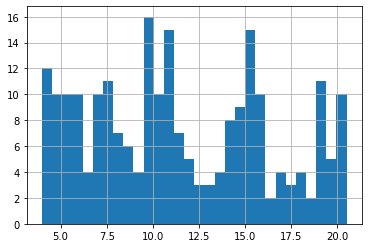

In [496]:
long_avg_delay_5_10_df.hh_num.hist(bins=30)

In [511]:
comp_df = dep_arr_df.describe().compare(long_avg_delay_5_10_df.describe())

In [512]:
comp_df[["M_count", "L_count", "H_count"]]

/home/service/miniconda3/envs/py39v7/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


M_count                   L_count                   H_count  \
               self       other          self       other          self   
count  35542.000000  146.000000  35542.000000  146.000000  35542.000000   
mean      12.577542   21.575342      0.038462   21.575342      2.241545   
std        4.813052    4.581576      0.197934    4.581576      2.139565   
min        0.000000    9.000000      0.000000    9.000000      0.000000   
25%        9.000000   18.000000      0.000000   18.000000      1.000000   
50%       13.000000   23.000000      0.000000   23.000000      2.000000   
75%       16.000000   25.000000      0.000000   25.000000      3.000000   
max       28.000000   30.000000      2.000000   30.000000     12.000000   

                   
            other  
count  146.000000  
mean    21.575342  
std      4.581576  
min      9.000000  
25%     18.000000  
50%     23.000000  
75%     25.000000  
max     30.000000

In [518]:
long_avg_delay_5_10_df.atmap_precipitation.value_counts()

0    77
1    69
Name: atmap_precipitation, dtype: int64

In [514]:
comp_df[
    [
        "atmap_visibility",
        "atmap_wind",
        "atmap_precipitation",
        "atmap_freezing",
        "atmap_danger",
    ]
]

atmap_visibility           atmap_wind        atmap_precipitation  \
                  self  other          self  other                self   
count     35542.000000  146.0  35542.000000  146.0        35542.000000   
mean          0.060970    0.0      0.008159    0.0            0.067019   
std           0.454288    0.0      0.108660    0.0            0.259989   
min                NaN    NaN           NaN    NaN                 NaN   
25%                NaN    NaN           NaN    NaN                 NaN   
50%                NaN    NaN           NaN    NaN                 NaN   
75%                NaN    NaN           NaN    NaN            0.000000   
max           5.000000    0.0      2.000000    0.0            3.000000   

                  atmap_freezing         atmap_danger         
            other           self  other          self  other  
count  146.000000   35542.000000  146.0  35542.000000  146.0  
mean     0.472603       0.083141    0.0      0.085645    0.0  
std      0.500967       0.293871    0.0      1.228046    0.0  
min           NaN            NaN    NaN           NaN    NaN  
25%           NaN            NaN    NaN           NaN    NaN  
50%           NaN            NaN    NaN           NaN    NaN  
75%      1.000000            NaN    NaN           NaN    NaN  
max      1.000000       4.000000    0.0     24.000000    0.0

#### ==> All atmap null appart from atmap_precipitation (avg=0.47)

5 oct is a rainy day that have a lot of H and M wtc , does similar days have the same high avg_outbound_delay_lastXmin

In [520]:
dep_arr_df.query(
    '"2019-10-28 00:00:00+00:00"<first_movement_start<"2019-10-29 00:00:00+00:00"'
)

/home/service/miniconda3/envs/py39v7/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


,flight_id,on_runway_time,taxi_holding_time,rwy_holding_time,total_holding_time,taxi_holding_time_minutes,first_movement,callsign,registration,typecode,...,nb,icao_wtc,H,L,L/M,M,H_count,L_count,L/M_count,M_count
17513,SWR155_13553,2019-10-28 05:04:01+00:00,0 days 00:00:00,None,0 days 00:00:00,0.000000,2019-10-28 05:04:15+00:00,SWR155,HB-JHL,A333,...,1.0,H,1,0,0,0,1.0,0.0,0.0,0.0
17514,SWR289_15363,2019-10-28 05:05:52+00:00,0 days 00:00:00,None,0 days 00:00:00,0.000000,2019-10-28 05:06:16+00:00,SWR289,HB-JMH,A343,...,2.0,H,1,0,0,0,2.0,0.0,0.0,0.0
17515,ETD39B_20492,2019-10-28 05:07:34+00:00,0 days 00:00:00,None,0 days 00:00:00,0.000000,2019-10-28 05:07:31+00:00,ETD39B,None,None,...,3.0,NaN,0,0,0,0,2.0,0.0,0.0,0.0
17516,SWR139_15438,2019-10-28 05:09:26+00:00,0 days 00:00:00,None,0 days 00:00:00,0.000000,2019-10-28 05:09:57+00:00,SWR139,HB-JNA,B77W,...,4.0,H,1,0,0,0,3.0,0.0,0.0,0.0
17517,GSW3403_15924,2019-10-28 05:11:46+00:00,0 days 00:00:00,None,0 days 00:00:00,0.000000,2019-10-28 05:11:59+00:00,GSW3403,HB-JOG,A319,...,5.0,M,0,0,0,1,3.0,0.0,0.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
18092,SWR288_13435,2019-10-28 21:52:47+00:00,0 days 00:07:02,None,0 days 00:07:02,7.033333,2019-10-28 21:45:58+00:00,SWR288,HB-JHL,A333,...,8.0,H,1,0,0,0,3.0,0.0,0.0,4.0
18094,SWR117E_12423,2019-10-28 21:53:06+00:00,0 days 00:01:18,None,0 days 00:01:18,1.300000,2019-10-28 21:50:34+00:00,SWR117E,None,None,...,10.0,NaN,0,0,0,0,3.0,0.0,0.0,4.0
18093,SWR92_15461,2019-10-28 21:56:38+00:00,0 days 00:01:23,None,0 days 00:04:36,1.383333,2019-10-28 21:47:36+00:00,SWR92,HB-JNE,B77W,...,9.0,H,1,0,0,0,4.0,0.0,0.0,3.0
18095,SWR176_15650,2019-10-28 22:01:28+00:00,0 days 00:00:00,None,0 days 00:06:43,0.000000,2019-10-28 21:54:21+00:00,SWR176,HB-JNJ,B77W,...,11.0,H,1,0,0,0,5.0,0.0,0.0,2.0


## Problem on asma mode (now fixed)


In [468]:
from ground_analysis.extract_flight_info import assign_asma_mode

asma_stats_df = pd.read_pickle("../data/intermediate/zurich_asma_stats3.pkl")

# Assigning text description of cluster (busy, disruted, nominal)
modes_df = assign_asma_mode(asma_stats_df)

# One hot encode 'mode' and compute the count for each half hour
modes_df.loc[:, ["busy", "disrupted", "nominal"]] = pd.get_dummies(modes_df["mode"])
modes_df = (
    modes_df.set_index("landing")
    .sort_index()
    .rolling("30T")
    .agg({"nominal": "sum", "busy": "sum", "disrupted": "sum"})
)

modes_df.loc[:, "not_nom_arrival_ratio"] = (
    modes_df["busy"] + modes_df["disrupted"]
) / (modes_df["busy"] + modes_df["disrupted"] + modes_df["nominal"])

In [493]:
pd.merge_asof(
    dep_arr_df.sort_values("first_movement_start"),
    modes_df,
    left_on="first_movement_start",
    right_index=True,
)

,flight_id,on_runway_time,taxi_holding_time,rwy_holding_time,total_holding_time,taxi_holding_time_minutes,first_movement,callsign,registration,typecode,...,L/M,M,H_count,L_count,L/M_count,M_count,nominal_y,busy_y,disrupted_y,not_nom_arrival_ratio
0,GSW4942_15738,2019-10-01 04:00:28+00:00,0 days 00:01:23,None,0 days 00:01:23,1.383333,2019-10-01 03:59:06+00:00,GSW4942,HB-JOG,A319,...,0,1,0.0,0.0,0.0,1.0,NaN,NaN,NaN,NaN
1,EDW200_5718,2019-10-01 04:10:37+00:00,0 days 00:01:18,None,0 days 00:04:56,1.300000,2019-10-01 04:03:36+00:00,EDW200,HB-IHZ,A320,...,0,1,3.0,0.0,0.0,2.0,NaN,NaN,NaN,NaN
2,SWR177_15809,2019-10-01 04:05:11+00:00,0 days 00:00:00,None,0 days 00:00:00,0.000000,2019-10-01 04:05:48+00:00,SWR177,HB-JNI,B77W,...,0,0,1.0,0.0,0.0,1.0,NaN,NaN,NaN,NaN
3,SWR139_15706,2019-10-01 04:07:25+00:00,0 days 00:00:00,None,0 days 00:00:00,0.000000,2019-10-01 04:07:33+00:00,SWR139,HB-JNG,B77W,...,0,0,2.0,0.0,0.0,1.0,NaN,NaN,NaN,NaN
4,SWR296_13638,2019-10-01 04:09:53+00:00,0 days 00:00:00,None,0 days 00:00:00,0.000000,2019-10-01 04:10:25+00:00,SWR296,HB-JHM,A333,...,0,0,3.0,0.0,0.0,1.0,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
35537,SWR176_15653,2019-11-30 22:02:47+00:00,0 days 00:02:16,None,0 days 00:15:41,2.266667,2019-11-30 21:44:51+00:00,SWR176,HB-JNJ,B77W,...,0,0,3.0,0.0,0.0,4.0,6.0,0.0,0.0,0.0
35538,SWR288_13280,2019-11-30 21:49:46+00:00,0 days 00:02:03,None,0 days 00:02:03,2.050000,2019-11-30 21:46:26+00:00,SWR288,HB-JHI,A333,...,0,0,2.0,0.0,0.0,6.0,6.0,0.0,0.0,0.0
35539,THY8HD_18663,2019-11-30 21:49:30+00:00,0 days 00:00:00,None,0 days 00:00:00,0.000000,2019-11-30 21:49:52+00:00,THY8HD,TC-JTN,A321,...,0,1,1.0,0.0,0.0,7.0,6.0,0.0,0.0,0.0
35540,SWR92_15689,2019-11-30 22:04:18+00:00,0 days 00:03:29,None,0 days 00:09:35,3.483333,2019-11-30 21:53:56+00:00,SWR92,None,None,...,0,0,3.0,0.0,0.0,4.0,6.0,0.0,0.0,0.0


In [491]:
asmaratio_chart = (
    alt.Chart(
        modes_df.reset_index().query("(landing.dt.day==8) & (landing.dt.month==10)")
    )
    .mark_line()
    .encode(x="landing:T", y="not_nom_arrival_ratio:Q")
)

delay_chart = (
    alt.Chart(
        dep_df_new.query(
            "(first_movement_start.dt.day==8) & (first_movement_start.dt.month==10) & end_pb==end_pb"
        )[
            [
                "avg_outbound_delay_lastXmin",
                "first_movement_start",
                "total_holding_time_minutes",
            ]
        ]
    )
    .mark_line(color="red")
    .encode(x="first_movement_start:T", y="total_holding_time_minutes:Q")
)

(asmaratio_chart + delay_chart).resolve_scale(y="independent")

/home/service/miniconda3/envs/py39v7/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


alt.LayerChart(...)

## wrt flight taxi delay

In [351]:
datachart = dep_df_new.query("end_pb==end_pb")[
    ["nb_dep", "avg_outbound_delay_lastXmin", "taxi_holding_time_minutes"]
]

alt.Chart(datachart).mark_boxplot().encode(
    x=alt.X("avg_outbound_delay_lastXmin", bin=alt.Bin(maxbins=40)),
    y="taxi_holding_time_minutes",
    color="count()",
)

alt.Chart(...)

## wrt nb dep

In [353]:
datachart = dep_df_new.query("end_pb==end_pb")[
    ["nb_dep", "avg_outbound_delay_lastXmin", "total_holding_time_minutes", "temp"]
]
alt.Chart(datachart).mark_boxplot(outliers=True).encode(
    x="nb_dep",
    y="avg_outbound_delay_lastXmin",
    color="mean(temp)",  # color="count()"
)

alt.Chart(...)

# avg_outbound_delay_lastXmin density sensibility

In [ ]:
dep_arr_df=not_nom_arrival_ratio

In [591]:
dep_df_new.columns

Index(['flight_id', 'on_runway_time', 'taxi_holding_time', 'rwy_holding_time',
       'total_holding_time', 'taxi_holding_time_minutes', 'first_movement',
       'callsign', 'registration', 'typecode', 'icao24', 'firstseen_min',
       'start', 'stop', 'duration', 'cumdist_max', 'parking_position',
       'parking_position_duration', 'runway', 'pb_duration', 'end_pb',
       'duration_minutes', 'parking_position_duration_minutes',
       'pb_duration_minutes', 'first_movement_start', 'taxi_dist',
       'total_holding_time_minutes', 'real_dur', 'real_dur_minutes', 'airline',
       'hh', 'hh_num', 'angle_sum', 'avg_speed', 'mvt_type', 'taxiing_stop',
       'avg_outbound_delay_lastXmin', 'nominal', 'busy', 'disrupted',
       'not_nom_arrival_ratio', 'press', 'temp', 'atmap_visibility',
       'atmap_wind', 'atmap_precipitation', 'atmap_freezing', 'atmap_danger',
       'config', 'nb_arr', 'nb_dep', 'nb', 'icao_wtc', 'H', 'L', 'L/M', 'M',
       'H_count', 'L_count', 'L/M_count', 'M_co

In [604]:
datachart = dep_df_new[["avg_outbound_delay_lastXmin", "not_nom_arrival_ratio"]]
datachart["not_nom_arrival_ratio_cat"] = np.where(
    datachart["not_nom_arrival_ratio"] > 0.15, 1, 0
)
alt.Chart(datachart).transform_density(
    "avg_outbound_delay_lastXmin", extent=[0, 20], groupby=["not_nom_arrival_ratio_cat"]
).mark_line().encode(x="value:Q", y="density:Q", color="not_nom_arrival_ratio_cat:N")

<ipython-input-604-fb321f5d6ea1>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  datachart["not_nom_arrival_ratio_cat"] = np.where(


alt.Chart(...)

In [605]:
datachart = dep_df_new[["total_holding_time_minutes", "not_nom_arrival_ratio"]]
datachart["not_nom_arrival_ratio_cat"] = np.where(
    datachart["not_nom_arrival_ratio"] > 0.15, 1, 0
)
alt.Chart(datachart).transform_density(
    "total_holding_time_minutes", extent=[0, 20], groupby=["not_nom_arrival_ratio_cat"]
).mark_line().encode(x="value:Q", y="density:Q", color="not_nom_arrival_ratio_cat:N")

/home/service/miniconda3/envs/py39v7/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)
<ipython-input-605-49b4b1c5db7d>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  datachart["not_nom_arrival_ratio_cat"] = np.where(


alt.Chart(...)